# How to Read the Startracker Data

created: 23th Feb, 2023

Johnny Esteves

According to merlin's message:
https://lsstc.slack.com/archives/C041MQGD8HM/p1677190892331609

```
from lsst.summit.utils.astrometry import CommandLineSolver
from lsst.summit.utils.astrometry.utils import runCharactierizeImage, filterSourceCatOnBrightest
from lsst.summit.utils.utils import starTrackerFileToExposure

filename = '/project/GenericCamera/101/2023/02/22/GC101_O_20230222_000085.fits'

solver = CommandLineSolver('/project/shared/ref_cats/astrometry_net/')
exp = starTrackerFileToExposure(filename)
charImageResult = runCharactierizeImage(exp, snr=5, minPix=25)
sources = filterSourceCatOnBrightest(charImageResult.sourceCat, 1)
result = solver.run(exp, sources, True)
print(result.wcs)
print(f"Astrometic scatter = {result.rmsErrorArsec:.02f} arcsec")
print(f"Astrometic scatter = {result.rmsErrorPixels:.02f} pixels")
```

In [1]:
# !pip install git+https://github.com/dwkim78/ASTRiDE


## Packages

In [1]:
from lsst.summit.utils.astrometry import CommandLineSolver
from lsst.summit.utils.astrometry.utils import runCharactierizeImage, filterSourceCatOnBrightest
from lsst.summit.utils.utils import starTrackerFileToExposure

In [2]:
filename = '/project/GenericCamera/101/2023/02/22/GC101_O_20230222_000085.fits'

solver = CommandLineSolver('/project/shared/ref_cats/astrometry_net/')
exp = starTrackerFileToExposure(filename)

/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-5.1.0/Linux64/afw/g093c4c12c6+579e1af31e/python/lsst/afw/image/_visitInfo.py:62: FutureWarning: Call to deprecated method getExposureId. (Replaced by VisitInfo.id for full focal plane identifiers and by ExposureInfo.id for detector-level identifiers. Will be removed after v25.) -- Deprecated since version v24.0.
  exposureId = self.getExposureId()


In [3]:
charImageResult = runCharactierizeImage(exp, snr=5, minPix=25)

In [4]:
sources = filterSourceCatOnBrightest(charImageResult.sourceCat, 1)
result = solver.run(exp, sources, True)
print(result.wcs)
print(f"Astrometic scatter = {result.rmsErrorArsec:.02f} arcsec")
print(f"Astrometic scatter = {result.rmsErrorPixels:.02f} pixels")

Catalog had 3139 sources, of which 3134 were above 0.1% of max
Fitting image with 200 sources of which 200 made it into the fit
Fitting code ran in 2.16 seconds
FITS standard SkyWcs:
Sky Origin: (125.8176834939, +9.8597796767)
Pixel Origin: (1558.85, 1255.15)
Pixel Scale: 8.66442 arcsec/pixel
Astrometic scatter = 4.19 arcsec
Astrometic scatter = 0.48 pixels


In [5]:
!pip3 install opencv-python

Defaulting to user installation because normal site-packages is not writeable


In [6]:
from __future__ import print_function, unicode_literals, absolute_import, division
import sys
import numpy as np
import matplotlib
matplotlib.rcParams["image.interpolation"] = None
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

/tmp/ipykernel_27311/4011289290.py:5: MatplotlibDeprecationWarning: Support for setting an rcParam that expects a str value to a non-str value is deprecated since 3.5 and support will be removed two minor releases later.
  matplotlib.rcParams["image.interpolation"] = None


In [7]:
def plot_img_label(img, img_title="image", lbl_title="label", **kwargs):
    fig, ai = plt.subplots(1,1, figsize=(12,5))
    im = ai.imshow(img, cmap='gray', clim=(0,1))
    ai.set_title(img_title)    
    fig.colorbar(im, ax=ai)

## Foreground/Background Segmentation

https://towardsdatascience.com/background-removal-with-python-b61671d1508a

In [8]:
import cv2
from astropy.io.fits import getdata
im = getdata('/home/adriansh95/DATA/starTracker/tmaTests/procFits/GC102_O_20221122_000042.fits')
# im = cv2.imread()

In [9]:
np.percentile(im.flatten(),[0, 25, 75,100])

array([    0.,   453.,   974., 16383.])

In [10]:
# Parameters
blur = 21
canny_low = 15
canny_high = 150
min_area = 0.0005
max_area = 0.95
dilate_iter = 10
erode_iter = 10
mask_color = (0.0,0.0,0.0)

In [11]:
# # Apply Canny Edge Dection
# edges = cv2.Canny(im, canny_low, canny_high)

In [12]:
def plot_img_label(img, lbl, img_title="image", lbl_title="edges", **kwargs):
    fig, (ai,al) = plt.subplots(1,2, figsize=(12,5), gridspec_kw=dict(width_ratios=(1.25,1)))
    im = ai.imshow(img, cmap='gray', clim=(0,1))
    ai.set_title(img_title)    
    fig.colorbar(im, ax=ai)
    al.imshow(lbl, cmap='gray')
    al.set_title(lbl_title)
    plt.tight_layout()

In [13]:
# plot_img_label(im, edges)

In [14]:
# get the contours and their areas
# contour_info = [(c, cv2.contourArea(c),) for c in cv2.findContours(edges, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)[1]]

In [15]:
# plt.imshow(edges!=0)

In [16]:
# help(cv2.Canny)

In [17]:
# ls /home/adriansh95/DATA/starTracker/tmaTests/procFits/GC102_O_20221122_000042.fits

In [18]:
from astropy.io import fits
from scipy.stats import sigmaclip
from mpl_toolkits.axes_grid1 import make_axes_locatable

def display(imArr, nStd = 5, gSig = 7):
    fig, ax = plt.subplots(1,1, figsize=(12,12))
    imArrClip, low, high = sigmaclip(imArr)
    mean = imArrClip.mean()
    std = imArrClip.std()
    im = ax.imshow(imArr, vmin=mean-nStd*std, vmax=mean+nStd*std, cmap='gray')
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right', size='5%', pad=0.05)
    fig.colorbar(im, cax=cax, orientation='vertical')

    plt.show()
    cax.cla()
    fig.savefig('test.png',dpi=125)

def read_image(filename):
    with fits.open(filename) as hdu:
        imArr = hdu[1].data
    return imArr

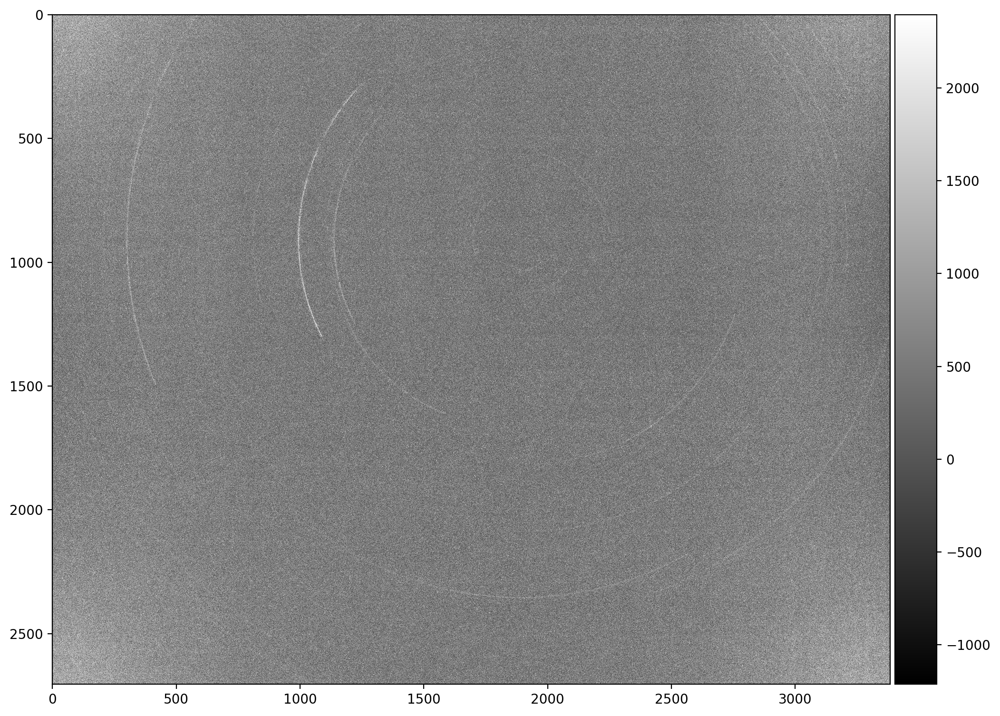

In [ ]:
im = read_image('/home/adriansh95/DATA/starTracker/tmaTests/procFits/GC102_O_20221122_000041.fits')
display(im)

In [ ]:
def apply_filter(A, smoothing, power=2.0):
    """Apply a hi/lo pass filter to a 2D image.
    
    The value of smoothing specifies the cutoff wavelength in pixels,
    with a value >0 (<0) applying a hi-pass (lo-pass) filter. The
    lo- and hi-pass filters sum to one by construction.  The power
    parameter determines the sharpness of the filter, with higher
    values giving a sharper transition.
    """
    if smoothing == 0:
        return A
    ny, nx = A.shape
    # Round down dimensions to even values for rfft.
    # Any trimmed row or column will be unfiltered in the output.
    nx = 2 * (nx // 2)
    ny = 2 * (ny // 2)
    T = np.fft.rfft2(A[:ny, :nx])
    # Last axis (kx) uses rfft encoding.
    kx = np.fft.rfftfreq(nx)
    ky = np.fft.fftfreq(ny)
    kpow = (kx ** 2 + ky[:, np.newaxis] ** 2) ** (power / 2.)
    k0pow = (1. / smoothing) ** power
    if smoothing > 0:
        F = kpow / (k0pow + kpow) # high pass
    else:
        F = k0pow / (k0pow + kpow) # low pass
    S = A.copy()
    S[:ny, :nx] = np.fft.irfft2(T * F)
    return S

In [ ]:
img1 = apply_filter(im, -10)
# img2 = apply_filter(img1, -1)

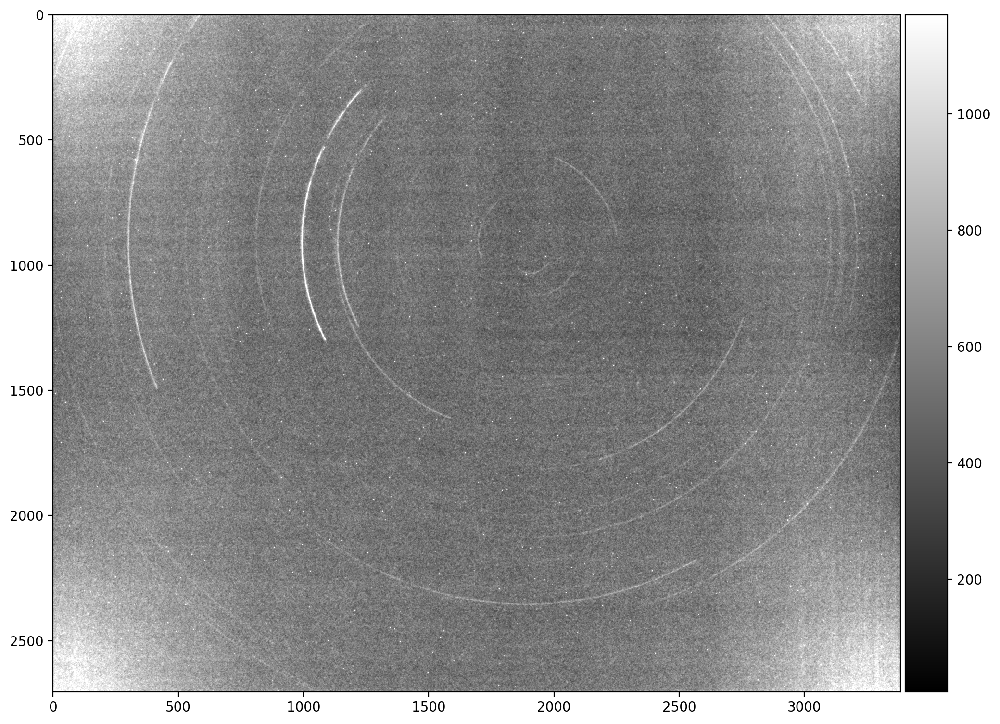

In [ ]:
display(img1)

/tmp/ipykernel_27311/1866465634.py:1: DeprecationWarning: Please use `gaussian_filter` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  from scipy.ndimage.filters import gaussian_filter


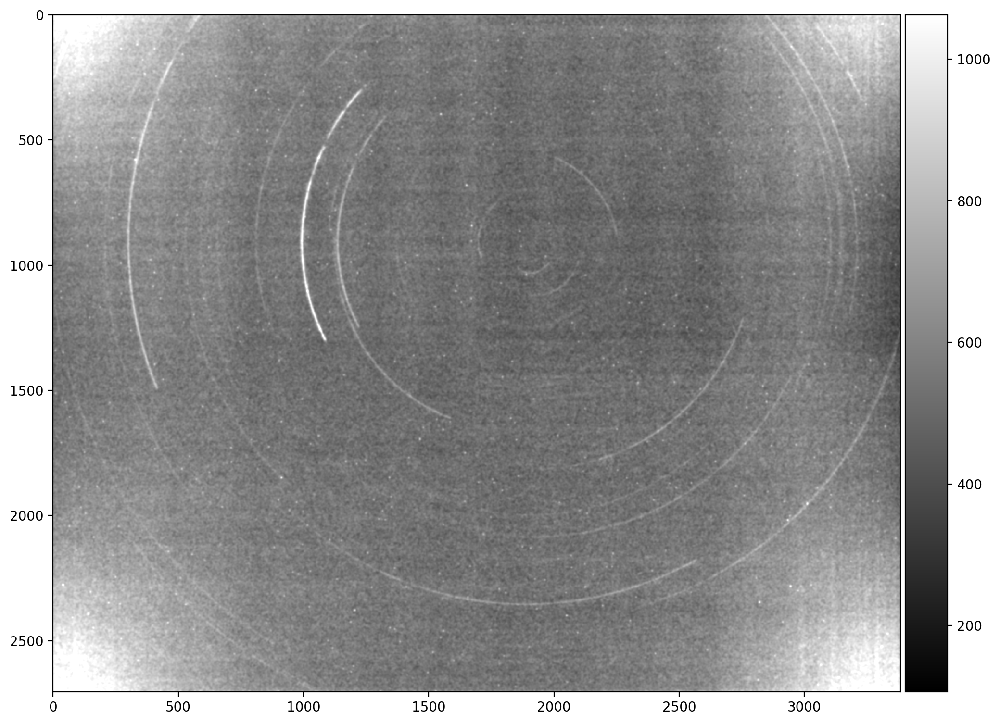

In [ ]:
from scipy.ndimage.filters import gaussian_filter
img2 = gaussian_filter(img1, 3)
display(img2)

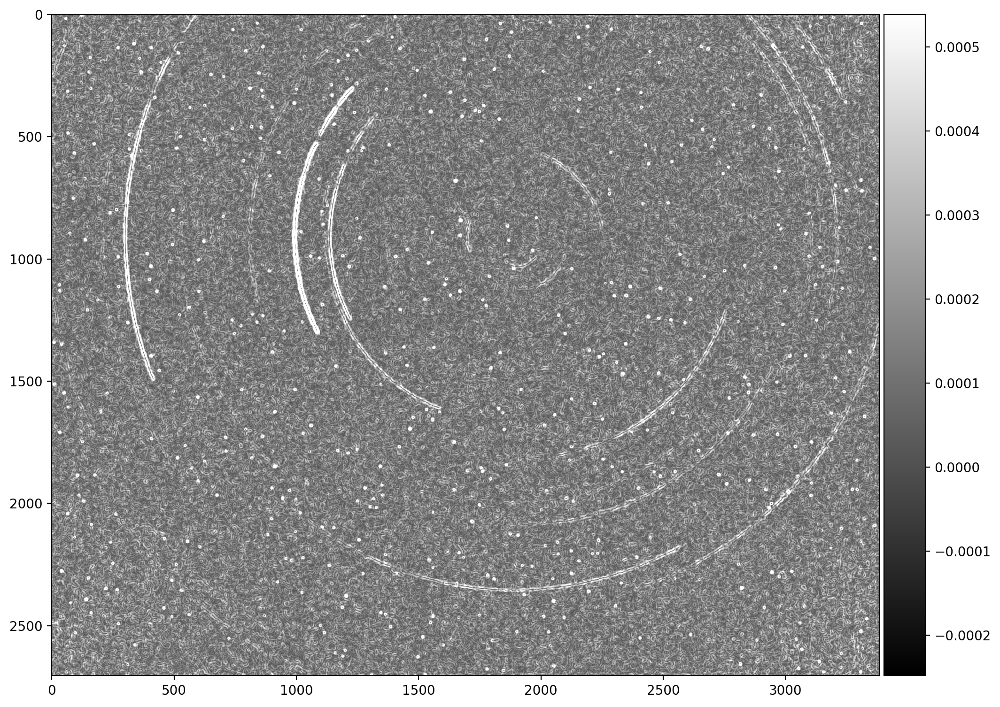

In [43]:
from skimage import filters
img3 = filters.sobel(img2)
display(img3)

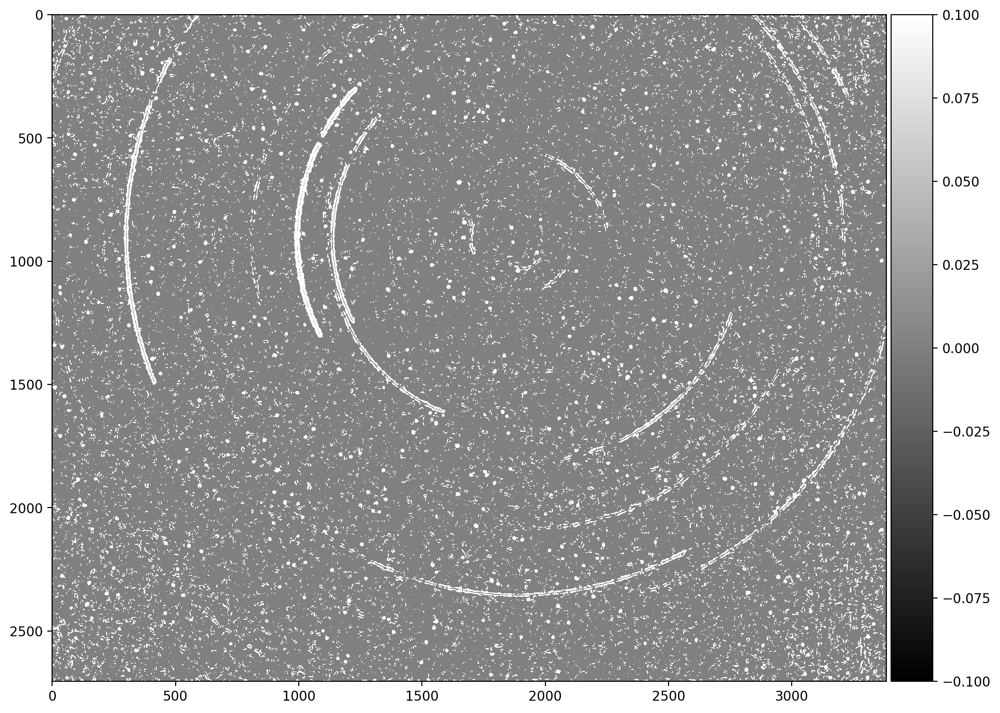

In [50]:
from skimage.filters import threshold_otsu, rank
from scipy import ndimage as ndi

thresh = threshold_otsu(img3)
# local_otsu = rank.otsu(img, footprint)

mask = img3 > 1.5*thresh
img4 = ndi.distance_transform_edt(mask)
display(img4)

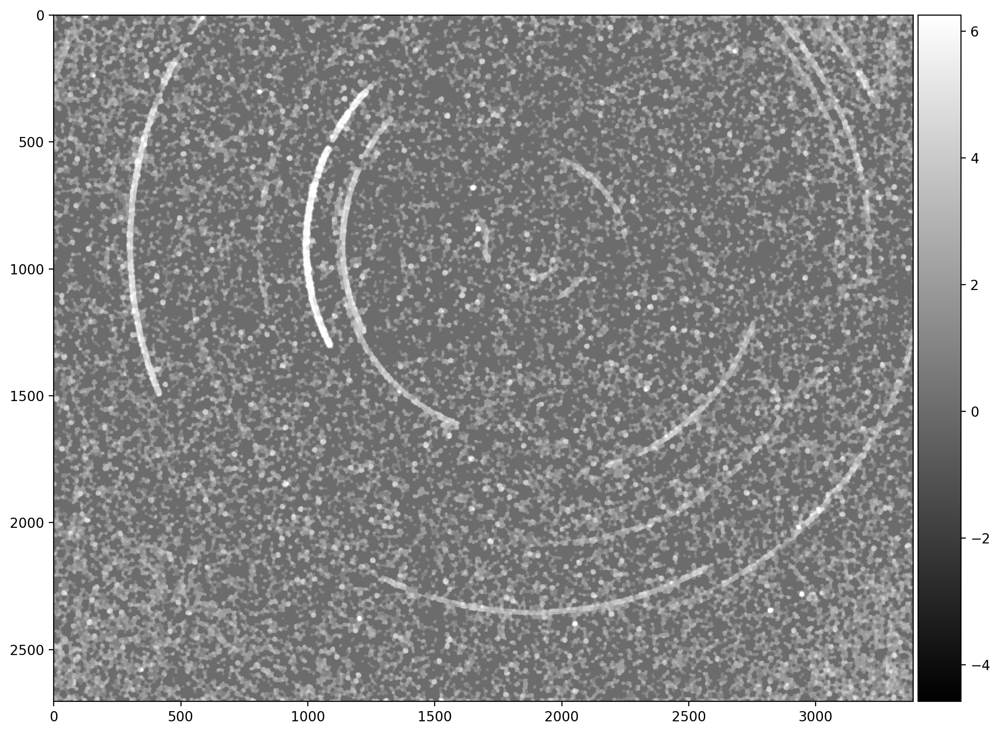

In [51]:
from skimage.morphology import closing, dilation
from skimage.morphology import disk

footprint = disk(5)
img5 = dilation(img4, footprint)
img5 = closing(img5, footprint)

display(img5)

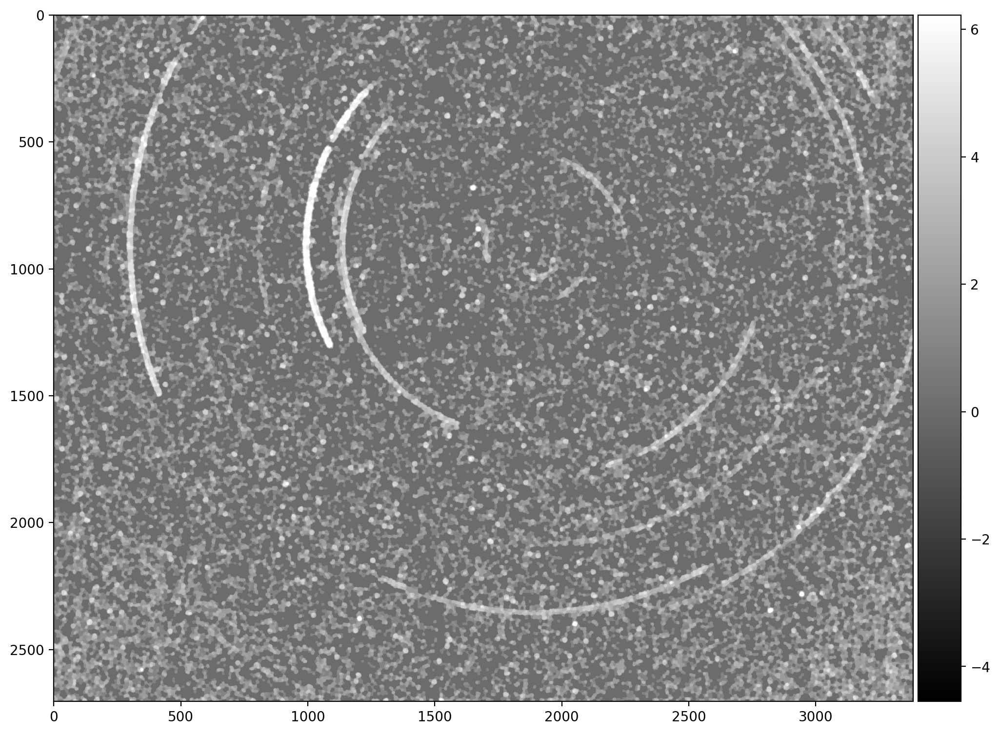

In [59]:
img6 = apply_filter(img5, -1.5)
display(img6)

/tmp/ipykernel_27311/1256869923.py:3: DeprecationWarning: Please use `label` from the `scipy.ndimage` namespace, the `scipy.ndimage.measurements` namespace is deprecated.
  labelarray, particle_count = ndimage.measurements.label(img5l)


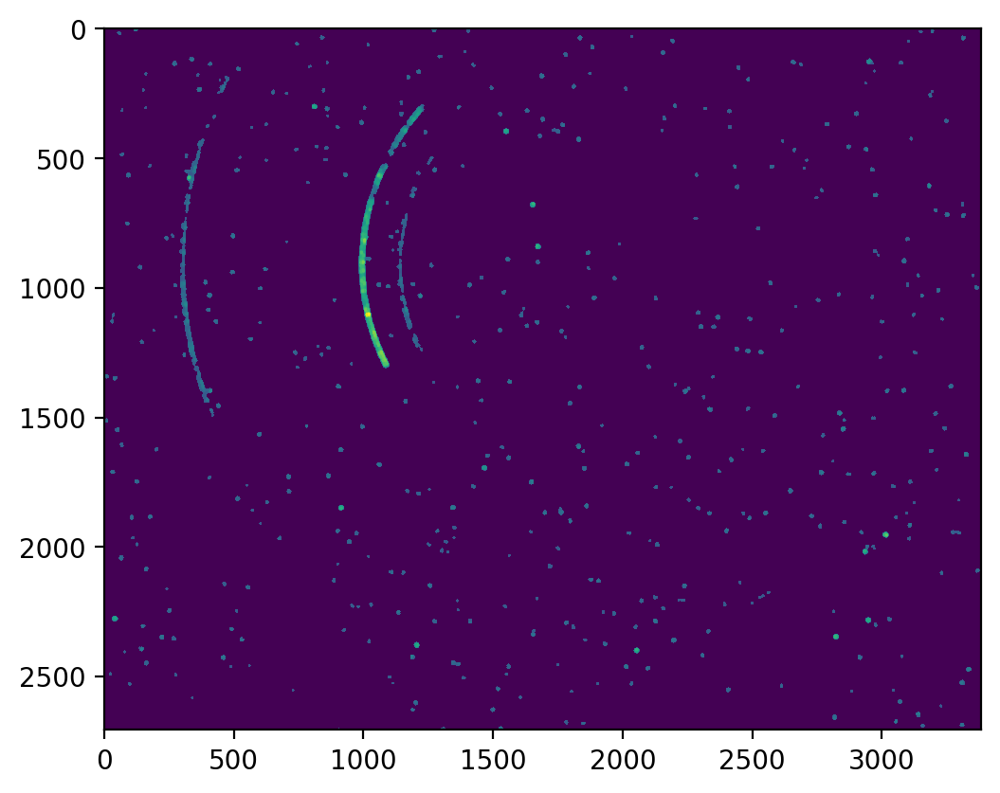

In [ ]:
from scipy import ndimage
img5l = np.where(img5>0.3*np.max(img5), img5.copy(), np.min(img5))
labelarray, particle_count = ndimage.measurements.label(img5l)
img6 = np.where(~labelarray, img5l.copy(), 0)
plt.imshow(img5l)

In [ ]:
# help(scipy.ndimage.measurements.label)

In [ ]:
labelarray

array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1]], dtype=int32)

In [ ]:
# from sklearn.decomposition import PCA
# pca = PCA(100)
# img_transformed = pca.fit_transform(im)
# img_inverted = pca.inverse_transform(img_transformed)


In [ ]:
# display(img_inverted)

In [ ]:
img_compressed = (np.dstack((red_inverted, red_inverted, red_inverted))).astype(np.uint8)


NameError: name 'red_inverted' is not defined

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import ndimage as ndi
from skimage.util import random_noise
from skimage import feature

image = ndi.gaussian_filter(-img2, 1)
image = random_noise(image, mode='speckle', mean=0.1)

# Compute the Canny filter for two values of sigma
edges1 = feature.canny(image)
edges2 = feature.canny(image, sigma=3)

# display results
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(8, 3))

ax[0].imshow(image, cmap='gray')
ax[0].set_title('noisy image', fontsize=20)

ax[1].imshow(edges1, cmap='gray')
ax[1].set_title(r'Canny filter, $\sigma=1$', fontsize=20)

ax[2].imshow(edges2, cmap='gray')
ax[2].set_title(r'Canny filter, $\sigma=3$', fontsize=20)

for a in ax:
    a.axis('off')

fig.tight_layout()
plt.show()

In [ ]:
np.percentile(im.flatten(), [50, 75, 95])

In [ ]:
# Apply Canny Edge Dection
im_copy = np.uint8(img)
edges = cv2.Canny(im_copy,150,500)
plt.imshow(edges)

In [ ]:
im_copy

In [ ]:
img.shape

In [ ]:
# img = np.expand_dims(im, axis=0)
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
edges = cv2.Canny(gray, 70, 110, apertureSize=3)
# and so on
lines = cv2.HoughLines(edges, 1, np.pi / 180, 150)

In [ ]:
debayered_image = cv2.cvtColor(im, cv2.COLOR_GR)


In [ ]:
im = cv2.imread('test.png', cv2.IMREAD_GRAYSCALE)
# im = im_copy
canny_low = 150
canny_high = 500

blur = cv2.blur(im,(10,10))

edges = cv2.Canny(im, canny_low, canny_high)
plt.imshow(edges)

In [ ]:
display(blur)

In [ ]:
cv2.blur(im, 50)

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
print(filename)
ax.cla()

with fits.open(filename) as hdu:
    imArr = hdu[1].data
    imArrClip, low, high = sigmaclip(imArr)
    mean = imArrClip.mean()
    std = imArrClip.std()
    im = ax.imshow(imArr, vmin=mean-nStd*std, vmax=mean+nStd*std)
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right', size='5%', pad=0.05)
    fig.colorbar(im, cax=cax, orientation='vertical')
        
plt.show()